# Imports

In [1]:
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support
import matplotlib.pyplot as plt
import seaborn as sn
import keras
import cv2
import numpy as np
import pandas as pd
import pickle
import os
import glob
import random
import albumentations as A
import pydot as pyd
keras.utils.vis_utils.pydot = pyd

Using TensorFlow backend.


# directories

In [2]:
current_dir = f'{os.getcwd()}'
camvid_dir = f'{current_dir}\\CamVid'
model_dir = f'{current_dir}\\Model'

# parameters

In [6]:
dimensions = (128, 128)
kernel = 3
pool_size = (2, 2)
    
random_seed = 2020
np.random.seed(seed=random_seed)
random.seed(random_seed)

# data processing

In [4]:
def get_class_data():
    class_file_path = f'{camvid_dir}\\class_dict.csv'
    class_df = pd.read_csv(class_file_path)
    
    n_classes = class_df.shape[0]
    
    class_color_dict = dict()
    color_class_dict = dict()
    class_label_dict = dict()
    
    for index, row in class_df.iterrows():
        color = (row['r'], row['g'], row['b'])
        class_color_dict[index] = color
        color_class_dict[color] = index
        class_label_dict[index] = row['name']
        
    return n_classes, class_color_dict, color_class_dict, class_label_dict
    

def load_image(image_path=None):
    image = cv2.imread(image_path)
    return image

def get_input_image(input_image_file_path=None, dimensions=None):
    input_image = load_image(image_path=input_image_file_path)
    input_image = cv2.resize(input_image, dimensions, interpolation=cv2.INTER_NEAREST)
    input_image = input_image.reshape((dimensions[0], dimensions[1], 3))
    input_image = input_image.astype('float32')
    input_image /= 255.0
    return input_image

def get_class(image=None, dimensions=None, n_classes=None, color_class_dict=None):
    class_no = np.empty(dimensions, dtype='uint8')
    class_freq = np.array([0] * n_classes)
    for i in range(dimensions[0]):
        for j in range(dimensions[0]):
            c_no = color_class_dict.get((image[i,j,2], image[i,j,1], image[i,j,0]), color_class_dict[(0, 0, 0)])
            class_no[i,j] = c_no
            class_freq[c_no] += 1
    return class_no, class_freq

def get_label(class_no=None, dimensions=None, n_classes=None):
    label = np.zeros((dimensions[0], dimensions[1], n_classes))
    for i in range(dimensions[0]):
        for j in range(dimensions[0]):
            label[i, j, class_no[i][j]] = 1
    return label

def get_output_label(output_image_file_path=None, dimensions=None, n_classes=None, color_class_dict=None):
    output_image = load_image(image_path=output_image_file_path)
    output_image = cv2.resize(output_image, dimensions, interpolation=cv2.INTER_NEAREST)
    output_image = output_image.reshape((dimensions[0], dimensions[1], 3))
    output_class_no, output_class_freq = get_class(image=output_image, dimensions=dimensions, n_classes=n_classes, color_class_dict=color_class_dict)
    output_label = get_label(class_no=output_class_no, dimensions=dimensions, n_classes=n_classes)
    return output_image, output_label, output_class_freq

def create_augmentation_pipeline():
    augmentation_pipeline = A.Compose(
        [
            A.OneOf(
                [
                    A.RandomBrightnessContrast(brightness_limit=0.5, contrast_limit=0.5, brightness_by_max=True, always_apply=True, p=0.5)
                ]
            )
        ]
    )   
    return augmentation_pipeline

def data_creator(input_image=None, output_image=None, output_label=None):
    ran = random.random()
    if ran < 0.5:
        aug_pipeline = create_augmentation_pipeline()
        augmented = aug_pipeline(image=input_image)
        input_image = augmented['image']
    ran = random.random()
    if ran < 0.5:
        #0:vertical 1:horizontal
        ran = random.randint(0, 1)
        input_image = cv2.flip(input_image, ran)
        output_image = cv2.flip(output_image, ran)
        output_label = cv2.flip(output_label, ran)    
    return input_image, output_image, output_label

def get_data(data_type=None, dimensions=None, n_classes=None, color_class_dict=None, apply_augmentation=True):
    
    input_dir = f'{camvid_dir}\\{data_type}'
    output_dir = f'{camvid_dir}\\{data_type}_labels'
    
    input_image_file_paths = [file_path for file_path in glob.glob(f'{input_dir}\\*.png')]
    output_image_file_paths = [file_path for file_path in glob.glob(f'{output_dir}\\*.png')]
        
    input_images = list()
    output_images = list()
    output_labels = list()
    class_freq = np.array([0] * n_classes)
    
    for input_image_file_path, output_image_file_path in zip(input_image_file_paths, output_image_file_paths):
        print('-', end='')
        input_image = get_input_image(input_image_file_path=input_image_file_path, dimensions=dimensions)
        output_image, output_label, output_class_freq = get_output_label(output_image_file_path=output_image_file_path, dimensions=dimensions, n_classes=n_classes, color_class_dict=color_class_dict)
        if apply_augmentation == True:
            input_image, output_image, output_label = data_creator(input_image=input_image, output_image=output_image, output_label=output_label)        
        input_images.append(input_image)
        output_images.append(output_image)
        output_labels.append(output_label)
        class_freq = np.add(class_freq, output_class_freq)
    print()
    
    input_images = np.array(input_images)
    output_images = np.array(output_images)
    output_labels = np.array(output_labels)
    
    return input_images, output_images, output_labels, class_freq

def show_graphs(history=None):
    history_dict = history
    acc = history_dict['accuracy']
    val_acc = history_dict['val_accuracy']
    loss = history_dict['loss']
    val_loss = history_dict['val_loss']
    epoches = range(1, len(acc)+1)

    plt.plot(epoches, loss, 'bo', label='Training Loss')
    plt.plot(epoches, val_loss, 'b', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoches')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    plt.clf()

    plt.plot(epoches, acc, 'bo', label='Training Accuracy')
    plt.plot(epoches, val_acc, 'b', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoches')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()
    
    return

def get_output_image(pred_proba=None, dimensions=None, class_color_dict=None):
    pred = np.empty((pred_proba.shape[0], dimensions[0], dimensions[1], 3), dtype='uint8')

    for index in range(pred_proba.shape[0]):
        for r in range(dimensions[0]):
            for c in range(dimensions[1]):
                c_w = pred_proba[index, r, c, :]
                c_no = np.argmax(c_w)
                color = class_color_dict[c_no]
                pred[index, r, c, 0], pred[index, r, c, 1], pred[index, r, c, 2] = color[2], color[1], color[0]
    
    return pred

def show_images(input_images=None, ground_truth_output_images=None, pred_images=None):
    for index in range(input_images.shape[0]):
        fig = plt.figure()

        splot1 = fig.add_subplot(1,3,1)
        splot1.set_title(f'Input')
        splot1.imshow(input_images[index])

        splot2 = fig.add_subplot(1,3,2)
        splot2.set_title(f'GroundTruth')
        splot2.imshow(ground_truth_output_images[index])

        splot3 = fig.add_subplot(1,3,3)
        splot3.set_title(f'Prediction')
        splot3.imshow(pred_images[index])
    return

def show_confusion_matrix(true=None, pred=None, class_label_dict=None, dimensions=None):
    y_true = list()
    y_pred = list()
    for index in range(true.shape[0]):
        for r in range(dimensions[0]):
            for c in range(dimensions[1]):
                t_c_no = np.argmax(true[index, r, c, :])
                p_c_no = np.argmax(pred[index, r, c, :])
                y_true.append(class_label_dict[t_c_no])
                y_pred.append(class_label_dict[p_c_no])
    cm = confusion_matrix(y_true, y_pred, labels=list(class_label_dict.values()))
    df_cm = pd.DataFrame(cm, index = list(class_label_dict.values()), columns = list(class_label_dict.values()))
    print(df_cm)
    plt.figure(figsize = (20,14))
    sn.heatmap(df_cm, annot=False)
    return

def get_precision_recall_fscore_support(true=None, pred=None, class_label_dict=None, dimensions=None):
    y_true = list()
    y_pred = list()
    for index in range(true.shape[0]):
        for r in range(dimensions[0]):
            for c in range(dimensions[1]):
                t_c_no = np.argmax(true[index, r, c, :])
                p_c_no = np.argmax(pred[index, r, c, :])
                y_true.append(class_label_dict[t_c_no])
                y_pred.append(class_label_dict[p_c_no])
    prfs = precision_recall_fscore_support(y_true, y_pred, labels=list(class_label_dict.values()), average=None)
    prfs = np.array(prfs).T
    df_prfs = pd.DataFrame(prfs, index = list(class_label_dict.values()), columns = ['precision', 'recall', 'fscore', 'support'])
    return df_prfs

# model creation

## custom MaxPoolingWithArgmax2D and MaxUnpooling2D layers

In [5]:
class MaxPoolingWithArgmax2D(keras.layers.Layer):
    def __init__(self, pool_size=(2, 2), strides=(2, 2), padding="same", **kwargs):
        super(MaxPoolingWithArgmax2D, self).__init__(**kwargs)
        self.padding = padding
        self.pool_size = pool_size
        self.strides = strides

    def call(self, inputs, **kwargs):
        padding = self.padding
        pool_size = self.pool_size
        strides = self.strides
        if keras.backend.backend() == 'tensorflow':
            ksize = [1, pool_size[0], pool_size[1], 1]
            padding = padding.upper()
            strides = [1, strides[0], strides[1], 1]
            output, argmax = keras.backend.tensorflow_backend.tf.nn.max_pool_with_argmax(
                inputs, ksize=ksize, strides=strides, padding=padding
            )
        else:
            errmsg = '{} backend is not supported for layer {}'.format(
                keras.backend.backend(), type(self).__name__
            )
            raise NotImplementedError(errmsg)
        argmax = keras.backend.cast(argmax, keras.backend.floatx())
        return [output, argmax]

    def compute_output_shape(self, input_shape):
        ratio = (1, 2, 2, 1)
        output_shape = [
            dim // ratio[idx] if dim is not None else None
            for idx, dim in enumerate(input_shape)
        ]
        output_shape = tuple(output_shape)
        return [output_shape, output_shape]

    def compute_mask(self, inputs, mask=None):
        return 2 * [None]


class MaxUnpooling2D(keras.layers.Layer):
    def __init__(self, size=(2, 2), **kwargs):
        super(MaxUnpooling2D, self).__init__(**kwargs)
        self.size = size

    def call(self, inputs, output_shape=None):
        updates, mask = inputs[0], inputs[1]
        with keras.backend.tensorflow_backend.tf.compat.v1.variable_scope(self.name):
            mask = keras.backend.cast(mask, 'int32')
            input_shape = keras.backend.tensorflow_backend.tf.shape(updates, out_type='int32')
            
            if output_shape is None:
                output_shape = (
                    input_shape[0],
                    input_shape[1] * self.size[0],
                    input_shape[2] * self.size[1],
                    input_shape[3],
                )
            self.output_shape1 = output_shape

            one_like_mask = keras.backend.ones_like(mask, dtype='int32')
            batch_shape = keras.backend.concatenate([[input_shape[0]], [1], [1], [1]], axis=0)
            batch_range = keras.backend.reshape(
                keras.backend.tensorflow_backend.tf.range(output_shape[0], dtype='int32'), shape=batch_shape
            )
            b = one_like_mask * batch_range
            y = mask // (output_shape[2] * output_shape[3])
            x = (mask // output_shape[3]) % output_shape[2]
            feature_range = keras.backend.tensorflow_backend.tf.range(output_shape[3], dtype='int32')
            f = one_like_mask * feature_range

            updates_size = keras.backend.tensorflow_backend.tf.size(updates)
            indices = keras.backend.transpose(keras.backend.reshape(keras.backend.stack([b, y, x, f]), [4, updates_size]))
            values = keras.backend.reshape(updates, [updates_size])
            ret = keras.backend.tensorflow_backend.tf.scatter_nd(indices, values, output_shape)
            return ret

    def compute_output_shape(self, input_shape):
        mask_shape = input_shape[1]
        return (
            mask_shape[0],
            mask_shape[1] * self.size[0],
            mask_shape[2] * self.size[1],
            mask_shape[3],
        )

## segnet model architecture

In [7]:
def get_segnet_model(input_shape=None, n_classes=None, kernel=None, pool_size=None):
    
    # encoder ====================================================================>
    inputs = keras.layers.Input(shape=input_shape)
    
    # ============================================================================>
    conv_1 = keras.layers.convolutional.Convolution2D(64, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(inputs)
    bn_1 = keras.layers.normalization.BatchNormalization()(conv_1)
    act_1 = keras.layers.core.Activation('relu')(bn_1)
    
    conv_2 = keras.layers.convolutional.Convolution2D(64, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_1)
    bn_2 = keras.layers.normalization.BatchNormalization()(conv_2)
    act_2 = keras.layers.core.Activation('relu')(bn_2)

    pool_1, mask_1 = MaxPoolingWithArgmax2D(pool_size)(act_2)

    # ============================================================================>
    conv_3 = keras.layers.convolutional.Convolution2D(128, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(pool_1)
    bn_3 = keras.layers.normalization.BatchNormalization()(conv_3)
    act_3 = keras.layers.core.Activation('relu')(bn_3)
    
    conv_4 = keras.layers.convolutional.Convolution2D(128, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_3)
    bn_4 = keras.layers.normalization.BatchNormalization()(conv_4)
    act_4 = keras.layers.core.Activation('relu')(bn_4)

    pool_2, mask_2 = MaxPoolingWithArgmax2D(pool_size)(act_4)

    # ============================================================================>
    conv_5 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(pool_2)
    bn_5 = keras.layers.normalization.BatchNormalization()(conv_5)
    act_5 = keras.layers.core.Activation('relu')(bn_5)
    
    conv_6 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_5)
    bn_6 = keras.layers.normalization.BatchNormalization()(conv_6)
    act_6 = keras.layers.core.Activation('relu')(bn_6)
    
    conv_7 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_6)
    bn_7 = keras.layers.normalization.BatchNormalization()(conv_7)
    act_7 = keras.layers.core.Activation('relu')(bn_7)

    pool_3, mask_3 = MaxPoolingWithArgmax2D(pool_size)(act_7)

    # ============================================================================>
    conv_8 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(pool_3)
    bn_8 = keras.layers.normalization.BatchNormalization()(conv_8)
    act_8 = keras.layers.core.Activation('relu')(bn_8)
    
    conv_9 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_8)
    bn_9 = keras.layers.normalization.BatchNormalization()(conv_9)
    act_9 = keras.layers.core.Activation('relu')(bn_9)
    
    conv_10 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_9)
    bn_10 = keras.layers.normalization.BatchNormalization()(conv_10)
    act_10 = keras.layers.core.Activation('relu')(bn_10)

    pool_4, mask_4 = MaxPoolingWithArgmax2D(pool_size)(act_10)
    
    # ============================================================================>
    conv_11 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(pool_4)
    bn_11 = keras.layers.normalization.BatchNormalization()(conv_11)
    act_11 = keras.layers.core.Activation('relu')(bn_11)
    
    conv_12 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_11)
    bn_12 = keras.layers.normalization.BatchNormalization()(conv_12)
    act_12 = keras.layers.core.Activation('relu')(bn_12)
    
    conv_13 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_12)
    bn_13 = keras.layers.normalization.BatchNormalization()(conv_13)
    act_13 = keras.layers.core.Activation('relu')(bn_13)

    pool_5, mask_5 = MaxPoolingWithArgmax2D(pool_size)(act_13)

    
    # decoder ====================================================================>
    unpool_1 = MaxUnpooling2D(pool_size)([pool_5, mask_5])

    conv_14 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(unpool_1)
    bn_14 = keras.layers.normalization.BatchNormalization()(conv_14)
    act_14 = keras.layers.core.Activation('relu')(bn_14)
    
    conv_15 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_14)
    bn_15 = keras.layers.normalization.BatchNormalization()(conv_15)
    act_15 = keras.layers.core.Activation('relu')(bn_15)
    
    conv_16 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_15)
    bn_16 = keras.layers.normalization.BatchNormalization()(conv_16)
    act_16 = keras.layers.core.Activation('relu')(bn_16)

    # ============================================================================>
    unpool_2 = MaxUnpooling2D(pool_size)([act_16, mask_4])

    conv_17 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(unpool_2)
    bn_17 = keras.layers.normalization.BatchNormalization()(conv_17)
    act_17 = keras.layers.core.Activation('relu')(bn_17)
    
    conv_18 = keras.layers.convolutional.Convolution2D(512, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_17)
    bn_18 = keras.layers.normalization.BatchNormalization()(conv_18)
    act_18 = keras.layers.core.Activation('relu')(bn_18)
    
    conv_19 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_18)
    bn_19 = keras.layers.normalization.BatchNormalization()(conv_19)
    act_19 = keras.layers.core.Activation('relu')(bn_19)

    # ============================================================================>
    unpool_3 = MaxUnpooling2D(pool_size)([act_19, mask_3])

    conv_20 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(unpool_3)
    bn_20 = keras.layers.normalization.BatchNormalization()(conv_20)
    act_20 = keras.layers.core.Activation('relu')(bn_20)
    
    conv_21 = keras.layers.convolutional.Convolution2D(256, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_20)
    bn_21 = keras.layers.normalization.BatchNormalization()(conv_21)
    act_21 = keras.layers.core.Activation('relu')(bn_21)
    
    conv_22 = keras.layers.convolutional.Convolution2D(128, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_21)
    bn_22 = keras.layers.normalization.BatchNormalization()(conv_22)
    act_22 = keras.layers.core.Activation('relu')(bn_22)

    # ============================================================================>
    unpool_4 = MaxUnpooling2D(pool_size)([act_22, mask_2])

    conv_23 = keras.layers.convolutional.Convolution2D(128, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(unpool_4)
    bn_23 = keras.layers.normalization.BatchNormalization()(conv_23)
    act_23 = keras.layers.core.Activation('relu')(bn_23)
    
    conv_24 = keras.layers.convolutional.Convolution2D(64, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(act_23)
    bn_24 = keras.layers.normalization.BatchNormalization()(conv_24)
    act_24 = keras.layers.core.Activation('relu')(bn_24)

    # ============================================================================>
    unpool_5 = MaxUnpooling2D(pool_size)([act_24, mask_1])

    conv_25 = keras.layers.convolutional.Convolution2D(64, (kernel, kernel), padding='same', kernel_initializer='he_uniform')(unpool_5)
    bn_25 = keras.layers.normalization.BatchNormalization()(conv_25)
    act_25 = keras.layers.core.Activation('relu')(bn_25)

    conv_26 = keras.layers.convolutional.Convolution2D(n_classes, (1, 1), padding='valid', kernel_initializer='he_uniform')(act_25)
    bn_26 = keras.layers.normalization.BatchNormalization()(conv_26)
    
    # ============================================================================>
    outputs = keras.layers.core.Activation('softmax')(bn_26)
    # done =======================================================================>
    
    
    segnet_model = keras.models.Model(inputs=inputs, outputs=outputs, name='SegNet')

    return segnet_model

In [8]:
n_classes, class_color_dict, color_class_dict, class_label_dict = get_class_data()

In [9]:
segnet_model = get_segnet_model(input_shape=(dimensions[0],dimensions[1],3), n_classes=n_classes, kernel=kernel, pool_size=pool_size)
keras.utils.plot_model(
    segnet_model,
    to_file=f'{model_dir}\\segnet_model.png',
    show_shapes=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
)
segnet_model.summary()
segnet_model_history = dict()
segnet_model_history['val_loss'] = list()
segnet_model_history['val_accuracy'] = list()
segnet_model_history['loss'] = list()
segnet_model_history['accuracy'] = list()

if os.path.exists(f'{model_dir}\\segnet_model_weights'):
    segnet_model.load_weights(f'{model_dir}\\segnet_model_weights')
else:
    segnet_model.save_weights(f'{model_dir}\\segnet_model_weights')

if os.path.exists(f'{model_dir}\\segnet_model_history'):
    with open(f'{model_dir}\\segnet_model_history', 'rb') as file:
        segnet_model_history = pickle.load(file)
else:
    with open(f'{model_dir}\\segnet_model_history', 'wb') as file:
        pickle.dump(segnet_model_history, file)

Model: "SegNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 64) 0           batch_normalization_1[0][0]      
_____________________________________________________________________________________________

# segnet model training and validation

In [10]:
n_classes, class_color_dict, color_class_dict, class_label_dict = get_class_data()

In [11]:
segnet_model = get_segnet_model(input_shape=(dimensions[0],dimensions[1],3), n_classes=n_classes, kernel=kernel, pool_size=pool_size)

segnet_model_history = dict()
segnet_model_history['val_loss'] = list()
segnet_model_history['val_accuracy'] = list()
segnet_model_history['loss'] = list()
segnet_model_history['accuracy'] = list()

if os.path.exists(f'{model_dir}\\segnet_model_weights'):
    segnet_model.load_weights(f'{model_dir}\\segnet_model_weights')

if os.path.exists(f'{model_dir}\\segnet_model_history'):
    with open(f'{model_dir}\\segnet_model_history', 'rb') as file:
        segnet_model_history = pickle.load(file)

In [12]:
train_images, train_outputs, train_labels, train_class_freq = get_data(data_type='train', dimensions=dimensions, n_classes=n_classes, color_class_dict=color_class_dict, apply_augmentation=True)
print(train_images.shape, train_outputs.shape, train_labels.shape)
print(train_class_freq)

median_class_freq = np.median(train_class_freq)
class_weights = np.array([median_class_freq/tcf for tcf in train_class_freq])
print(class_weights)

---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
(369, 128, 128, 3) (369, 128, 128, 3) (369, 128, 128, 32)
[    292    2858   28753    2622 1386398  188350    1575    1933   62076
  100891  111727     687   39921     336   28324   21259   37505 1703076
   14801  413240    7765  928149   32185     249   22038       0  615077
   11230       1   49787  158140   74451]
[9.77345890e+01 9.98547936e+00 9.92539909e-01 1.08842487e+01
 2.05846373e-02 1.51518450e-01 1.81196825e+01 1.47638386e+01
 4.59734841e-01 2.82864676e-01 2.55430648e-01 4.15407569e+01
 7.14874377e-01 8.49360119e+01 1.00757308e+00 1.34241968e+00
 7.60925210e-01 1.67570326e-02 1.92814675e+00 6.90603523e-02
 3.675

In [13]:
val_images, val_outputs, val_labels, val_class_freq = get_data(data_type='val', dimensions=dimensions, n_classes=n_classes, color_class_dict=color_class_dict, apply_augmentation=True)
print(val_images.shape, val_outputs.shape, val_labels.shape)
print(val_class_freq)

----------------------------------------------------------------------------------------------------
(100, 128, 128, 3) (100, 128, 128, 3) (100, 128, 128, 32)
[    57   3717   7976    464 368712  59138    638    343  16522  20652
  27710    795   9880    107   5996   4004  10025 465536   6507  98288
   1777 260844  12287    106   7023      0 168007   6888      0  15428
  39479  19494]


In [14]:
segnet_model.compile(loss='categorical_crossentropy', optimizer=keras.optimizers.SGD(lr=0.001, momentum=0.9, decay=0.0), metrics=['accuracy'])

In [46]:
initial_epoch = len(segnet_model_history.get('accuracy', list()))
print(f'initial epoch : {initial_epoch}')
next_epoches = 4
print(f'next epochs : {next_epoches}')

history = segnet_model.fit(
    train_images, 
    train_labels, 
    batch_size=12, 
    epochs=initial_epoch + next_epoches,
    verbose=1,
    shuffle=True,
    class_weight=class_weights,
    initial_epoch=initial_epoch,
    validation_data=(val_images, val_labels)
)

segnet_model.save_weights(f'{model_dir}\\segnet_model_weights')
segnet_model.load_weights(f'{model_dir}\\segnet_model_weights')

segnet_model_history['val_loss'].extend(history.history['val_loss'])
segnet_model_history['val_accuracy'].extend(history.history['val_accuracy'])
segnet_model_history['loss'].extend(history.history['loss'])
segnet_model_history['accuracy'].extend(history.history['accuracy'])

with open(f'{model_dir}\\segnet_model_history', 'wb') as file:
    pickle.dump(segnet_model_history, file)
with open(f'{model_dir}\\segnet_model_history', 'rb') as file:
    segnet_model_history = pickle.load(file)

initial epoch : 240
next epochs : 4
Train on 369 samples, validate on 100 samples
Epoch 241/244
369/369 [==============================] - 600s 2s/step - loss: 0.6098 - accuracy: 0.8455 - val_loss: 1.0009 - val_accuracy: 0.7453
Epoch 242/244
369/369 [==============================] - 614s 2s/step - loss: 0.6070 - accuracy: 0.8458 - val_loss: 0.9834 - val_accuracy: 0.7475
Epoch 243/244
369/369 [==============================] - 601s 2s/step - loss: 0.6178 - accuracy: 0.8434 - val_loss: 1.0322 - val_accuracy: 0.7319
Epoch 244/244
369/369 [==============================] - 597s 2s/step - loss: 0.6117 - accuracy: 0.8453 - val_loss: 1.0022 - val_accuracy: 0.7431


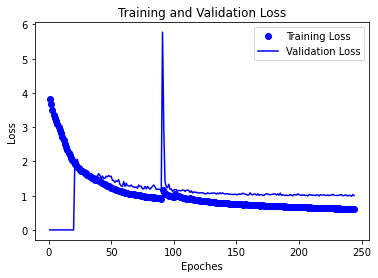

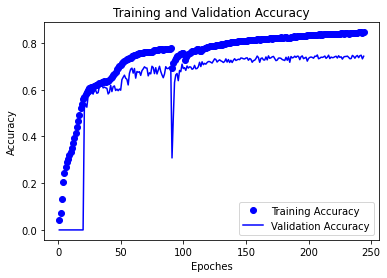

In [15]:
show_graphs(history=segnet_model_history)

In [16]:
print(f'evaluation of segnet on training data : ')

loss, accuracy = segnet_model.evaluate(
    train_images,
    train_labels,
    verbose=1
)

print(f'loss : {loss}')
print(f'accuracy : {accuracy}')

evaluation of segnet on training data : 
369/369 [==============================] - 195s 529ms/step
loss : 0.7173007361611053
accuracy : 0.8097500801086426


In [17]:
print(f'evaluation of segnet on validation data : ')

loss, accuracy = segnet_model.evaluate(
    val_images,
    val_labels,
    verbose=1
)

print(f'loss : {loss}')
print(f'accuracy : {accuracy}')

evaluation of segnet on validation data : 
100/100 [==============================] - 52s 525ms/step
loss : 1.0021786427497863
accuracy : 0.7431433200836182


In [18]:
print(f'prediction of segnet on training data : ')

train_pred_proba = segnet_model.predict(
    train_images,
    batch_size=12,
    verbose=1
)

prediction of segnet on training data : 
369/369 [==============================] - 195s 529ms/step


In [19]:
print(f'prediction of segnet on validation data : ')

val_pred_proba = segnet_model.predict(
    val_images,
    batch_size=12,
    verbose=1
)

prediction of segnet on validation data : 
100/100 [==============================] - 50s 500ms/step


In [20]:
train_pred = get_output_image(pred_proba=train_pred_proba, dimensions=dimensions, class_color_dict=class_color_dict)

In [21]:
val_pred = get_output_image(pred_proba=val_pred_proba, dimensions=dimensions, class_color_dict=class_color_dict)

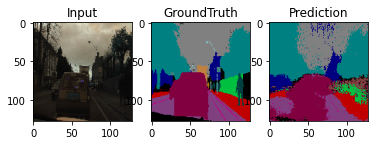

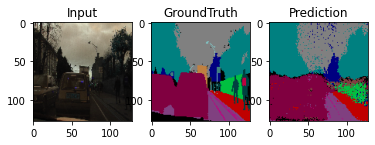

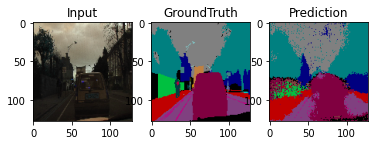

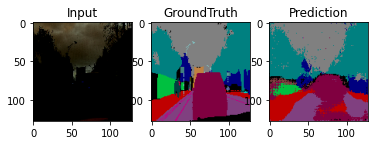

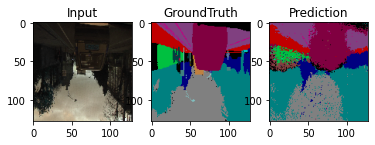

...

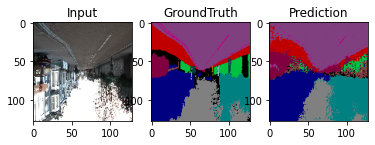

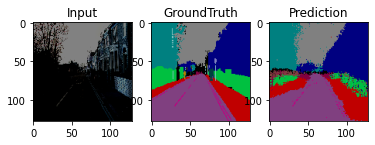

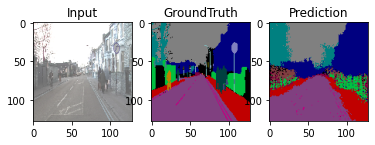

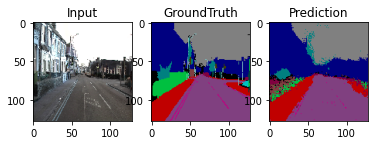

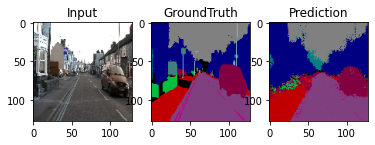

In [22]:
show_images(input_images=train_images, ground_truth_output_images=train_outputs, pred_images=train_pred)

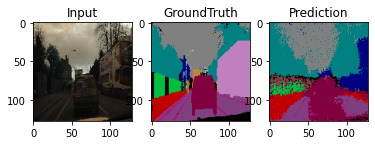

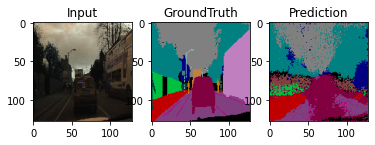

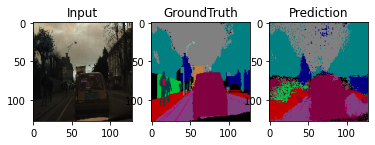

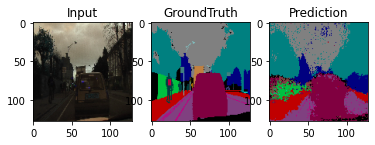

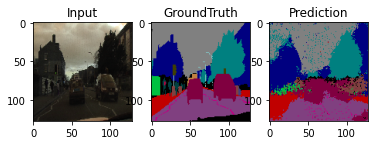

...

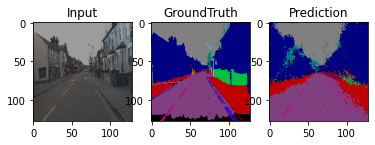

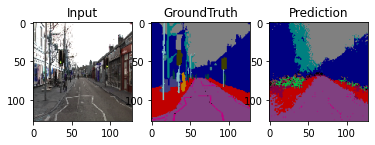

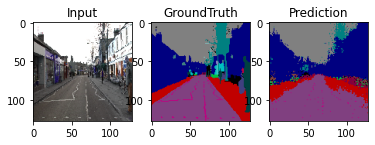

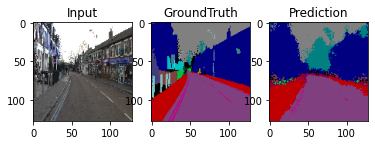

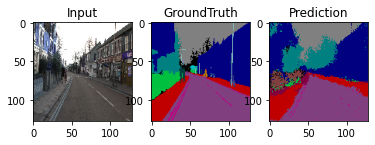

In [23]:
show_images(input_images=val_images, ground_truth_output_images=val_outputs, pred_images=val_pred)

                   Animal  Archway  Bicyclist  Bridge  Building     Car  \
Animal                  0        0          0       0        35       9   
Archway                 0        0          0       0       715      14   
Bicyclist               0        0          0       0      8287    6351   
Bridge                  0        0          0       0      1202     376   
Building                0        0          0       0   1329072    4386   
Car                     0        0          0       0     14266  143108   
CartLuggagePram         0        0          0       0       638     252   
Child                   0        0          0       0       790     494   
Column_Pole             0        0          0       0     28646    4113   
Fence                   0        0          0       0      8979    6398   
LaneMkgsDriv            0        0          0       0        50    3542   
LaneMkgsNonDriv         0        0          0       0         1      45   
Misc_Text               0

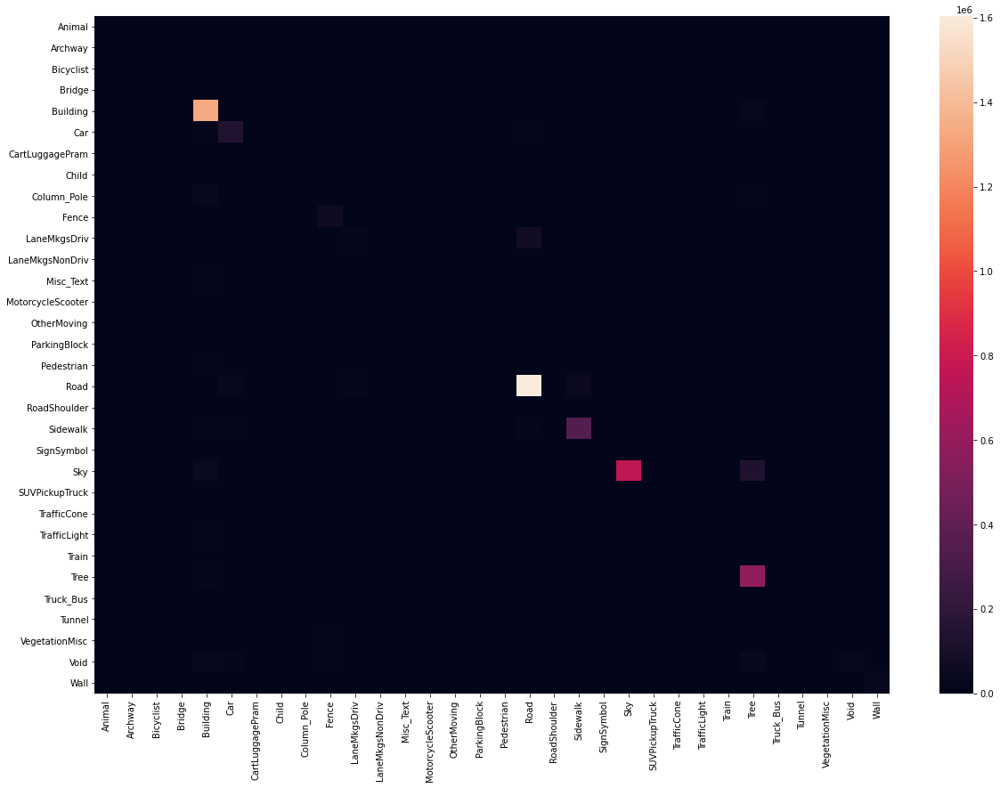

In [24]:
show_confusion_matrix(true=train_labels, pred=train_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)

                   Animal  Archway  Bicyclist  Bridge  Building    Car  \
Animal                  0        0          0       0         4      0   
Archway                 0        0          0       0      2072      3   
Bicyclist               0        0          0       0      1834   2106   
Bridge                  0        0          0       0       335     15   
Building                0        0          0       0    322990   5235   
Car                     0        0          0       0      5286  36269   
CartLuggagePram         0        0          0       0       300    102   
Child                   0        0          0       0       110     99   
Column_Pole             0        0          0       0      7667   1392   
Fence                   0        0          0       0      3635   2374   
LaneMkgsDriv            0        0          0       0        24    995   
LaneMkgsNonDriv         0        0          0       0         8     12   
Misc_Text               0        0    

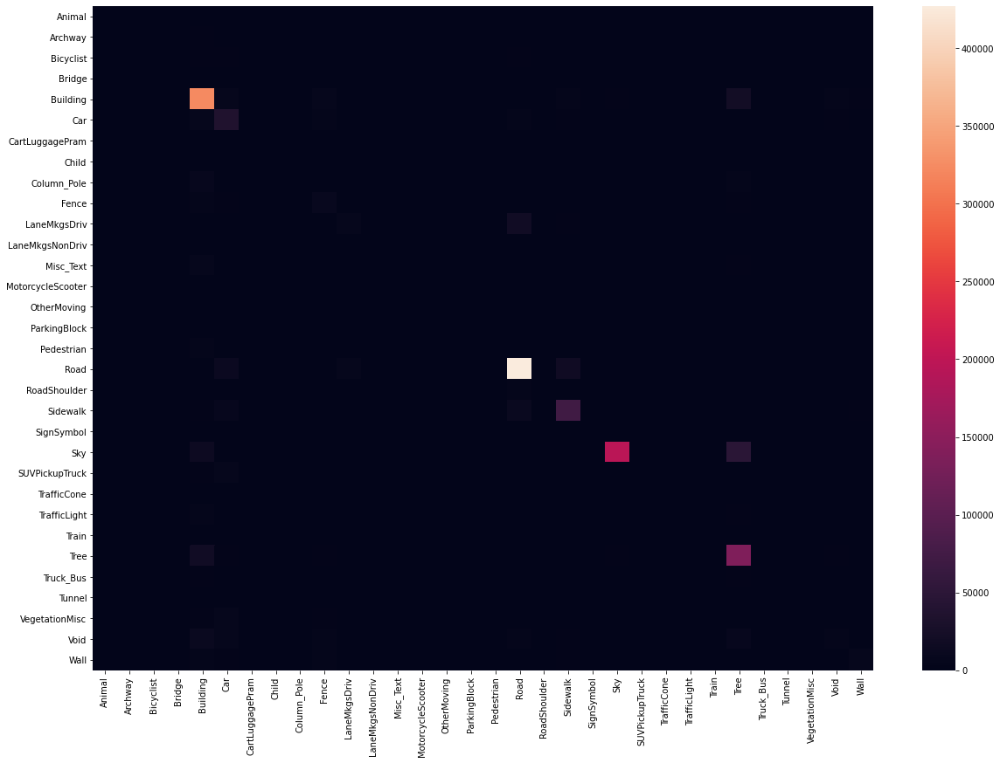

In [25]:
show_confusion_matrix(true=val_labels, pred=val_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)

In [26]:
df_train_prfs = get_precision_recall_fscore_support(true=train_labels, pred=train_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)
print(df_train_prfs)

                   precision    recall    fscore    support
Animal              0.000000  0.000000  0.000000      292.0
Archway             0.000000  0.000000  0.000000     2858.0
Bicyclist           0.000000  0.000000  0.000000    28753.0
Bridge              0.000000  0.000000  0.000000     2622.0
Building            0.831025  0.958651  0.890287  1386398.0
Car                 0.481220  0.759798  0.589242   188350.0
CartLuggagePram     0.000000  0.000000  0.000000     1575.0
Child               0.000000  0.000000  0.000000     1933.0
Column_Pole         0.000000  0.000000  0.000000    62076.0
Fence               0.425258  0.575621  0.489145   100891.0
LaneMkgsDriv        0.494901  0.224109  0.308512   111727.0
LaneMkgsNonDriv     0.000000  0.000000  0.000000      687.0
Misc_Text           0.000000  0.000000  0.000000    39921.0
MotorcycleScooter   0.000000  0.000000  0.000000      336.0
OtherMoving         0.000000  0.000000  0.000000    28324.0
ParkingBlock        0.000000  0.000000  

In [27]:
df_val_prfs = get_precision_recall_fscore_support(true=val_labels, pred=val_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)
print(df_val_prfs)

                   precision    recall    fscore   support
Animal              0.000000  0.000000  0.000000      57.0
Archway             0.000000  0.000000  0.000000    3717.0
Bicyclist           0.000000  0.000000  0.000000    7976.0
Bridge              0.000000  0.000000  0.000000     464.0
Building            0.767728  0.875995  0.818296  368712.0
Car                 0.369850  0.613294  0.461432   59138.0
CartLuggagePram     0.000000  0.000000  0.000000     638.0
Child               0.000000  0.000000  0.000000     343.0
Column_Pole         0.000000  0.000000  0.000000   16522.0
Fence               0.243905  0.440829  0.314050   20652.0
LaneMkgsDriv        0.429208  0.201516  0.274263   27710.0
LaneMkgsNonDriv     0.000000  0.000000  0.000000     795.0
Misc_Text           0.000000  0.000000  0.000000    9880.0
MotorcycleScooter   0.000000  0.000000  0.000000     107.0
OtherMoving         0.000000  0.000000  0.000000    5996.0
ParkingBlock        0.000000  0.000000  0.000000    4004

# segnet model evaluation

In [28]:
n_classes, class_color_dict, color_class_dict, class_label_dict = get_class_data()

In [29]:
segnet_model = get_segnet_model(input_shape=(dimensions[0],dimensions[1],3), n_classes=n_classes, kernel=kernel, pool_size=pool_size)

if os.path.exists(f'{model_dir}\\segnet_model_weights'):
    segnet_model.load_weights(f'{model_dir}\\segnet_model_weights')

In [30]:
test_images, test_outputs, test_labels, test_class_freq = get_data(data_type='test', dimensions=dimensions, n_classes=n_classes, color_class_dict=color_class_dict, apply_augmentation=False)
print(test_images.shape, test_outputs.shape, test_labels.shape)
print(test_class_freq)

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
(232, 128, 128, 3) (232, 128, 128, 3) (232, 128, 128, 32)
[   217    821  23737   2188 870996 142998   1246    999  34411  42196
  53922     96  18065    733  11472  13032  26142 925740   8099 218824
   3908 658377  36744     35  13976      0 421599  43214      0  22637
 143329  61335]


In [31]:
segnet_model.compile(loss='categorical_crossentropy', optimizer=keras.optimizers.SGD(lr=0.001, momentum=0.9, decay=0.0), metrics=['accuracy'])

In [32]:
print(f'evaluation of segnet on testing data : ')

loss, accuracy = segnet_model.evaluate(
    test_images,
    test_labels,
    verbose=1
)

print(f'loss : {loss}')
print(f'accuracy : {accuracy}')

evaluation of segnet on testing data : 
232/232 [==============================] - 127s 547ms/step
loss : 1.1325214772388852
accuracy : 0.6955529451370239


In [33]:
print(f'prediction of segnet on testing data : ')

test_pred_proba = segnet_model.predict(
    test_images,
    batch_size=12,
    verbose=1
)

prediction of segnet on testing data : 
232/232 [==============================] - 127s 547ms/step


In [34]:
test_pred = get_output_image(pred_proba=test_pred_proba, dimensions=dimensions, class_color_dict=class_color_dict)

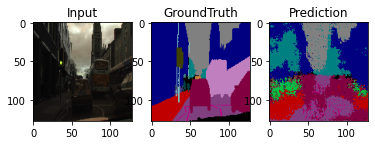

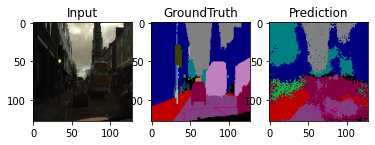

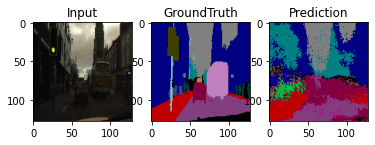

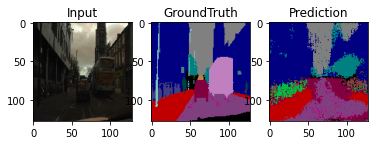

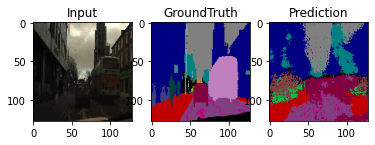

...

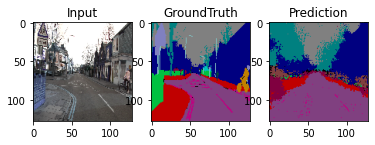

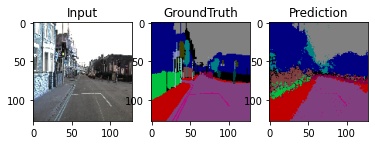

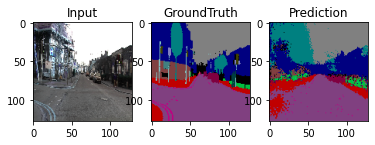

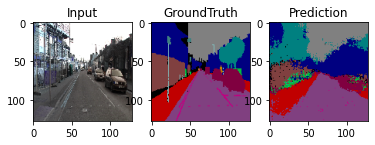

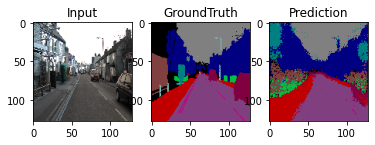

In [35]:
show_images(input_images=test_images, ground_truth_output_images=test_outputs, pred_images=test_pred)

                   Animal  Archway  Bicyclist  Bridge  Building    Car  \
Animal                  0        0          0       0         7     32   
Archway                 0        0          0       0        84      0   
Bicyclist               0        0          0       0      4164   7854   
Bridge                  0        0          0       0       864    244   
Building                0        0          0       0    664008  13963   
Car                     0        0          0       0     11832  85711   
CartLuggagePram         0        0          0       0       378    287   
Child                   0        0          0       0       251    137   
Column_Pole             0        0          0       0     13529   3015   
Fence                   0        0          0       0      8199   3657   
LaneMkgsDriv            0        0          0       0        42   2571   
LaneMkgsNonDriv         0        0          0       0         0      1   
Misc_Text               0        0    

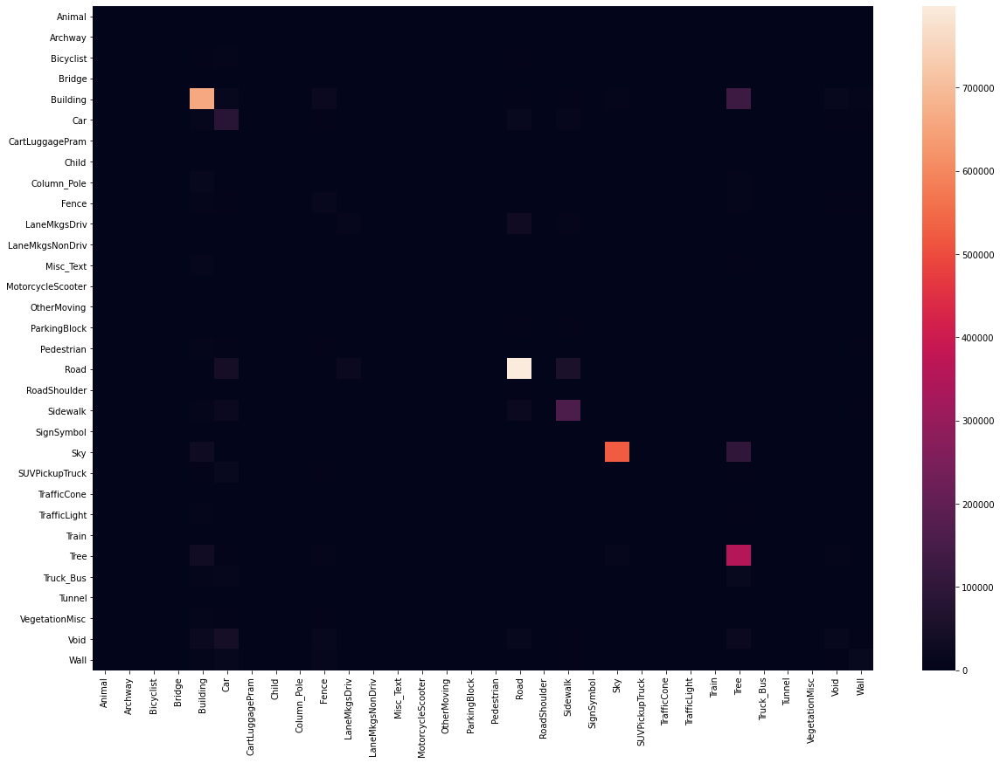

In [36]:
show_confusion_matrix(true=test_labels, pred=test_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)

In [37]:
df_test_prfs = get_precision_recall_fscore_support(true=test_labels, pred=test_pred_proba, class_label_dict=class_label_dict, dimensions=dimensions)
print(df_test_prfs)

                   precision    recall    fscore   support
Animal              0.000000  0.000000  0.000000     217.0
Archway             0.000000  0.000000  0.000000     821.0
Bicyclist           0.000000  0.000000  0.000000   23737.0
Bridge              0.000000  0.000000  0.000000    2188.0
Building            0.770556  0.762355  0.766433  870996.0
Car                 0.296965  0.599386  0.397159  142998.0
CartLuggagePram     0.000000  0.000000  0.000000    1246.0
Child               0.000000  0.000000  0.000000     999.0
Column_Pole         0.000000  0.000000  0.000000   34411.0
Fence               0.136628  0.336975  0.194425   42196.0
LaneMkgsDriv        0.287255  0.203053  0.237923   53922.0
LaneMkgsNonDriv     0.000000  0.000000  0.000000      96.0
Misc_Text           0.000000  0.000000  0.000000   18065.0
MotorcycleScooter   0.000000  0.000000  0.000000     733.0
OtherMoving         0.000000  0.000000  0.000000   11472.0
ParkingBlock        0.000000  0.000000  0.000000   13032